<h1 style='font-size: 50px; text-align: center; font-family: 'Formata', serif;'>
    Analysis of Complex Data, Master in Data Science & Engineering, 2023-2024
</h1>

#   1. Import libraries, classes, custom functions, and data load</h1>

In [1]:
import sys
import os

# Get the directory path of the notebook
notebook_directory = os.path.dirname(os.path.abspath("__file__"))

# Get the directory path of the project (one level up)
project_directory = os.path.dirname(notebook_directory)

# Add the project directory to the Python module search path
sys.path.append(project_directory)

# Now you can import the LoadJSON module from DataLoaderLocal
from shared_utilities.DataLoaderLocal import LoadJSON

import pandas as pd
import numpy as np
import utility_func as utils
import gdown
import networkx as nx
import community as community_louvain
import matplotlib.cm as cm
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from tabulate import tabulate
from sklearn.cluster import DBSCAN
import plotly.express as px
import igraph as ig
import folium
from folium.plugins import HeatMap
import seaborn as sns

from igraph import Graph, plot, RainbowPalette, ClusterColoringPalette

# Adjust display options to show all columns
pd.set_option('display.max_columns', None)

/Users/luish/anaconda3/lib/python3.10/site-packages/lightfm/_lightfm_fast.py:9: UserWarning: LightFM was compiled without OpenMP support. Only a single thread will be used.
  warnings.warn(


In [2]:
############## Or go to Section 3 (DP - Data Preparation) to load a CSV file specifically created for the Recommendation System ##############
business, reviews, users = LoadJSON()

utils.YelpDatasets(business_df = business, reviews_df = reviews, users_df = users)

Business DataFrame's head:


,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
0,Pns2l4eNsfO8kk83dixA6A,"Abby Rappoport, LAC, CMQ","1616 Chapala St, Ste 2",Santa Barbara,CA,93101,34.426679,-119.711197,5.0,7,0,{'ByAppointmentOnly': 'True'},"Doctors, Traditional Chinese Medicine, Naturop...",None
1,mpf3x-BjTdTEA3yCZrAYPw,The UPS Store,87 Grasso Plaza Shopping Center,Affton,MO,63123,38.551126,-90.335695,3.0,15,1,{'BusinessAcceptsCreditCards': 'True'},"Shipping Centers, Local Services, Notaries, Ma...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-18:30', ..."
2,tUFrWirKiKi_TAnsVWINQQ,Target,5255 E Broadway Blvd,Tucson,AZ,85711,32.223236,-110.880452,3.5,22,0,"{'BikeParking': 'True', 'BusinessAcceptsCredit...","Department Stores, Shopping, Fashion, Home & G...","{'Monday': '8:0-22:0', 'Tuesday': '8:0-22:0', ..."
3,MTSW4McQd7CbVtyjqoe9mw,St Honore Pastries,935 Race St,Philadelphia,PA,19107,39.955505,-75.155564,4.0,80,1,"{'RestaurantsDelivery': 'False', 'OutdoorSeati...","Restaurants, Food, Bubble Tea, Coffee & Tea, B...","{'Monday': '7:0-20:0', 'Tuesday': '7:0-20:0', ..."
4,mWMc6_wTdE0EUBKIGXDVfA,Perkiomen Valley Brewery,101 Walnut St,Green Lane,PA,18054,40.338183,-75.471659,4.5,13,1,"{'BusinessAcceptsCreditCards': 'True', 'Wheelc...","Brewpubs, Breweries, Food","{'Wednesday': '14:0-22:0', 'Thursday': '16:0-2..."



Reviews DataFrame's head:


,review_id,user_id,business_id,stars,useful,funny,cool,text,date
0,KU_O5udG6zpxOg-VcAEodg,mh_-eMZ6K5RLWhZyISBhwA,XQfwVwDr-v0ZS3_CbbE5Xw,3,0,0,0,"If you decide to eat here, just be aware it is...",2018-07-07 22:09:11
1,BiTunyQ73aT9WBnpR9DZGw,OyoGAe7OKpv6SyGZT5g77Q,7ATYjTIgM3jUlt4UM3IypQ,5,1,0,1,I've taken a lot of spin classes over the year...,2012-01-03 15:28:18
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
3,AqPFMleE6RsU23_auESxiA,_7bHUi9Uuf5__HHc_Q8guQ,kxX2SOes4o-D3ZQBkiMRfA,5,1,0,1,"Wow! Yummy, different, delicious. Our favo...",2015-01-04 00:01:03
4,Sx8TMOWLNuJBWer-0pcmoA,bcjbaE6dDog4jkNY91ncLQ,e4Vwtrqf-wpJfwesgvdgxQ,4,1,0,1,Cute interior and owner (?) gave us tour of up...,2017-01-14 20:54:15



Users DataFrame's head:


,user_id,name,review_count,yelping_since,useful,funny,cool,elite,friends,fans,average_stars,compliment_hot,compliment_more,compliment_profile,compliment_cute,compliment_list,compliment_note,compliment_plain,compliment_cool,compliment_funny,compliment_writer,compliment_photos
0,qVc8ODYU5SZjKXVBgXdI7w,Walker,585,2007-01-25 16:47:26,7217,1259,5994,2007,"NSCy54eWehBJyZdG2iE84w, pe42u7DcCH2QmI81NX-8qA...",267,3.91,250,65,55,56,18,232,844,467,467,239,180
1,j14WgRoU_-2ZE1aw1dXrJg,Daniel,4333,2009-01-25 04:35:42,43091,13066,27281,"2009,2010,2011,2012,2013,2014,2015,2016,2017,2...","ueRPE0CX75ePGMqOFVj6IQ, 52oH4DrRvzzl8wh5UXyU0A...",3138,3.74,1145,264,184,157,251,1847,7054,3131,3131,1521,1946
2,2WnXYQFK0hXEoTxPtV2zvg,Steph,665,2008-07-25 10:41:00,2086,1010,1003,"2009,2010,2011,2012,2013","LuO3Bn4f3rlhyHIaNfTlnA, j9B4XdHUhDfTKVecyWQgyA...",52,3.32,89,13,10,17,3,66,96,119,119,35,18
3,SZDeASXq7o05mMNLshsdIA,Gwen,224,2005-11-29 04:38:33,512,330,299,"2009,2010,2011","enx1vVPnfdNUdPho6PH_wg, 4wOcvMLtU6a9Lslggq74Vg...",28,4.27,24,4,1,6,2,12,16,26,26,10,9
4,hA5lMy-EnncsH4JoR-hFGQ,Karen,79,2007-01-05 19:40:59,29,15,7,,"PBK4q9KEEBHhFvSXCUirIw, 3FWPpM7KU1gXeOM_ZbYMbA...",1,3.54,1,1,0,0,0,1,1,0,0,0,0


## 1.1 TUCSON


In [3]:
# 1. Filtering data for the city of Tucson and "open" in the "business" table only:
df_business_open_tucson = business[(business['city'] == 'Tucson') & (business['is_open'] == 1)]

# Filtering reviews related to businesses in Tucson:
df_reviews_tucson = reviews[reviews['business_id'].isin(df_business_open_tucson['business_id'])]

In [4]:
df_business_open_tucson.head()

,business_id,name,address,city,state,postal_code,latitude,longitude,stars,review_count,is_open,attributes,categories,hours
16,rBmpy_Y1UbBx8ggHlyb7hA,Arizona Truck Outfitters,625 N Stone Ave,Tucson,AZ,85705,32.229872,-110.972342,4.5,10,1,"{'DriveThru': 'False', 'BusinessAcceptsCreditC...","Automotive, Auto Parts & Supplies, Auto Custom...","{'Monday': '0:0-0:0', 'Tuesday': '8:0-17:0', '..."
56,txyXRytGjwOXvS8s4sc-WA,Smoothie King,1070 E Tucson Marketplace Blvd,Tucson,AZ,85713,32.186794,-110.954765,3.0,29,1,"{'RestaurantsPriceRange2': '2', 'BusinessParki...","Vitamins & Supplements, Ice Cream & Frozen Yog...","{'Monday': '0:0-0:0', 'Tuesday': '7:0-21:0', '..."
67,eYxGFkxo6m3SYGVTh5m2nQ,Big Boyz Toyz Motorcycle Rentals,4158 E Grant Rd,Tucson,AZ,85712,32.250324,-110.903655,4.5,8,1,None,"Towing, Hotels & Travel, Automotive, Motorcycl...","{'Monday': '8:30-18:0', 'Tuesday': '8:30-18:0'..."
121,luGY5CJlb4CJ3LrBcSXMPA,Desert Design Center,4146 E Speedway Blvd,Tucson,AZ,85712,32.235866,-110.903676,3.0,5,1,"{'BusinessParking': '{'garage': False, 'street...","Furniture Stores, Shopping, Home & Garden","{'Monday': '9:30-18:0', 'Tuesday': '9:30-18:0'..."
125,wEfK2HIYNzkA1QYfUjHBaw,Leslie's,"7955 E Broadway Blvd, Ste 147",Tucson,AZ,85710,32.221542,-110.822101,2.5,15,1,"{'BusinessAcceptsCreditCards': 'True', 'Busine...","Hardware Stores, Home Services, Hot Tub & Pool...","{'Monday': '9:0-17:0', 'Tuesday': '7:0-18:0', ..."


In [5]:
df_reviews_tucson.head()

,review_id,user_id,business_id,stars,useful,funny,cool,text,date
2,saUsX_uimxRlCVr67Z4Jig,8g_iMtfSiwikVnbP2etR0A,YjUWPpI6HXG530lwP-fb2A,3,0,0,0,Family diner. Had the buffet. Eclectic assortm...,2014-02-05 20:30:30
14,UBp0zWyH60Hmw6Fsasei7w,4Uh27DgGzsp6PqrH913giQ,otQS34_MymijPTdNBoBdCw,4,0,2,0,The bun makes the Sonoran Dog. It's like a snu...,2011-10-27 17:12:05
75,ymhbOMW63B_vGaRFR3XT0A,yZdAhQ_KmKuCZmbBy9YDQg,5Ce3lZksYVkCbrihqylVHQ,5,0,0,0,I just started going to Sushi Nara this month ...,2014-07-25 17:56:26
93,onlgwy5qGDEzddsrnIvtWg,pYXeL0RCqus2IfhthYCOyA,W7NxQw8UYFR0HLPrI08tvw,4,0,0,0,Don't know what it is but If my tummy's feelin...,2012-02-01 14:21:25
147,ypFqmURIY41F4pWaMW1VrQ,hToW2eoTAYlOcuNz7I73Cg,7L1kXfwU5XM6f6Jxo_L7Yg,5,1,0,0,We've been coming here since I was a kid. The ...,2015-07-03 22:36:04


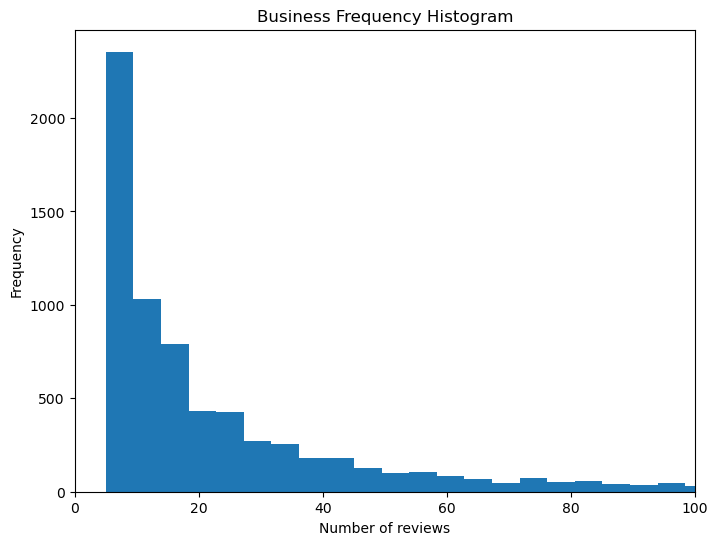

In [16]:
business_counts = utils.NumReviewsBusiness(df_reviews_tucson)

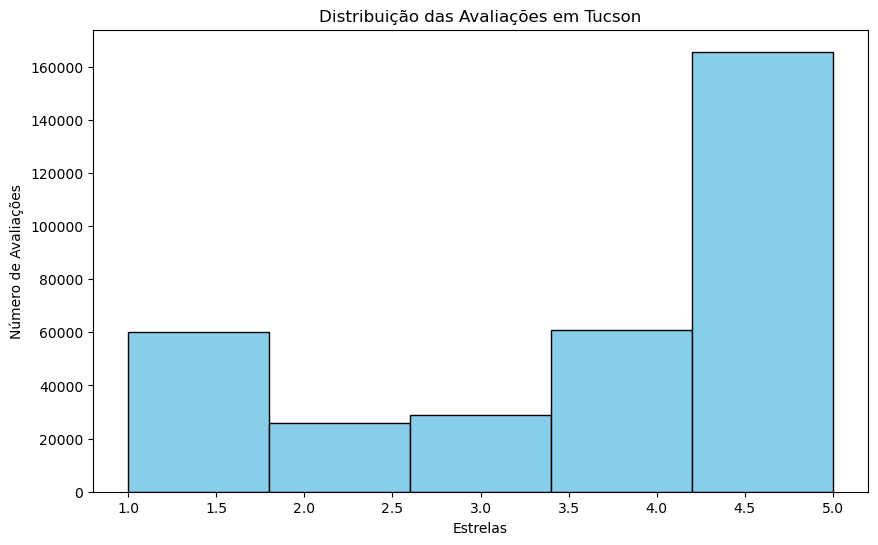

In [17]:
# Create an histogram
plt.figure(figsize=(10, 6))
plt.hist(df_reviews_tucson['stars'], bins=5, color='skyblue', edgecolor='black')
plt.xlabel('Estrelas')
plt.ylabel('Número de Avaliações')
plt.title('Distribuição das Avaliações em Tucson')
# Remove grids
plt.grid(False)

# Set background color to white
plt.gca().set_facecolor('white')
plt.show()

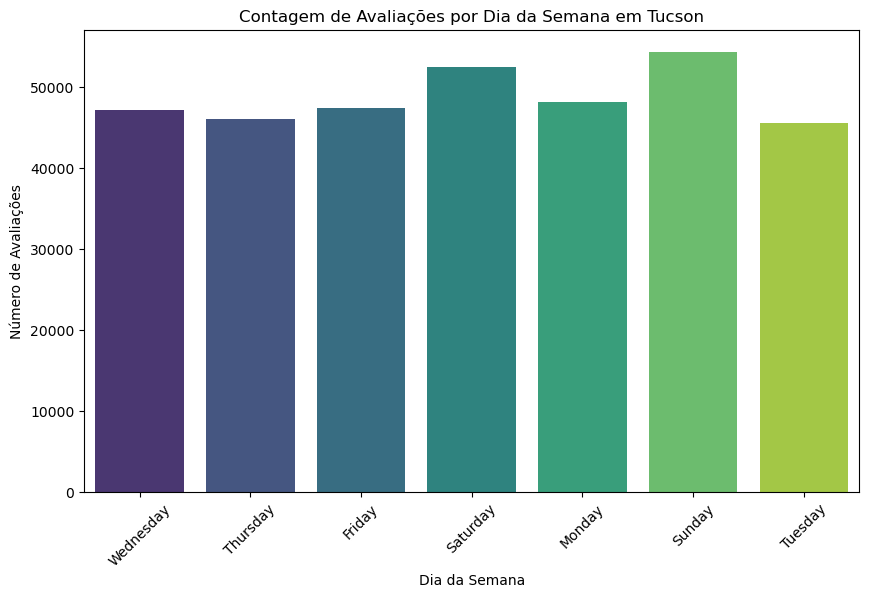

In [18]:
# Convert the 'date' column to a date type
df_reviews_tucson['date'] = pd.to_datetime(df_reviews_tucson['date'])

# Extract the day of the week
df_reviews_tucson['day_week'] = df_reviews_tucson['date'].dt.day_name()

# Count of reviews per day of the week
count_day_week = df_reviews_tucson['day_week'].value_counts()

# Create a stacked bar chart
plt.figure(figsize=(10, 6))
sns.countplot(data=df_reviews_tucson, x='day_week', palette='viridis')
plt.xlabel('Day of the week')
plt.ylabel('Number of Reviews')
plt.title('Review Count by Day of the Week in Tucson')
plt.xticks(rotation=45)
# Remove grids
plt.grid(False)

# Set background color to white
plt.gca().set_facecolor('white')
plt.show()

In [14]:
# Create a base map in Tucson
map_tucson = folium.Map(location=[32.2226, -110.9747], zoom_start=12)

df_reviews_tucson = df_reviews_tucson.merge(df_business_open_tucson[['business_id', 'latitude', 'longitude']], on='business_id', how='inner')

# Create a list of review coordinates
coords = df_reviews_tucson[['latitude', 'longitude']].values

# Add the heat map
HeatMap(coords).add_to(map_tucson)

# Display the map
map_tucson

## 2. DP - Data Preparation

In [5]:
# Preparae the daatframe from the json files for the Tucson City
city = 'Tucson'

rs_dataset, user_mapping = utils.PrepareDataFrameRS(business_df = business, 
                                      reviews_df = reviews, 
                                      users_df = users, 
                                      city = city,
                                      categories_to_filter = 'Sandwich')

rs_dataset

,user_id,business_id,stars
0,0,0,5
1,1,0,3
2,2,0,5
3,3,0,4
4,4,0,4
...,...,...,...
30455,18425,268,2
30456,4080,268,1
30457,18426,268,1
30458,2934,268,2


In [6]:
# we will use the pivot function
matrix = rs_dataset.pivot(index = 'user_id', columns = 'business_id', values = 'stars')

print(f"Dataset's sparsity: {matrix.notnull().sum().sum() / (matrix.shape[0] * matrix.shape[1]):.2%}")

Dataset's sparsity: 0.59%


In [ ]:
# CSV file ready for Recommendation System building
rs_dataset = pd.read_csv('yelp_dataset/rs_dataset.csv')

In [2]:
#Use the CSV file from Google drive
url='https://drive.google.com/file/d/1YkU4wycHX-917CjGddrN-mRpX8LvTN-I/view?usp=sharing'
url='https://drive.google.com/uc?id=' + url.split('/')[-2]
rs_dataset = pd.read_csv(url)
rs_dataset.head(10)

,user_id,business_id,stars
0,0,0,3
1,1,0,2
2,2,0,5
3,3,0,5
4,4,0,3
5,5,0,4
6,6,0,4
7,7,0,5
8,8,0,4
9,9,0,5


In [7]:
trainset, testset = utils.PrepareDataSurprise(df = rs_dataset)
##### Start with a lower sample size value, for example 50k, otherwise your computer will die #####
ubcf_trainset, ubcf_testset = utils.PrepareDataSurprise(df = rs_dataset, sample_size=20000)

In [8]:
# Get the number of users and items in the trainset
num_users = trainset.n_users
num_items = trainset.n_items

# Get the number of ratings in the trainset
num_ratings = trainset.n_ratings

print(f"Number of users: {num_users}")
print(f"Number of items: {num_items}")
print(f"Number of ratings: {num_ratings}")

Number of users: 18293
Number of items: 269
Number of ratings: 28866


#  3. DM - Data Modeling

In [9]:
# Random Recommender
random_algo, random_rmse, random_predictions = utils.RandomRecommender(data_train = trainset, 
                                                                       data_test = testset)

RMSE: 1.9238


In [10]:
# User-Based Collaborative Filtering
ubcf_algo, ubcf_rmse, ubcf_predictions = utils.UserBasedCollaborativeFiltering(data_train = trainset, 
                                                                               data_test = testset)

Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.4609


In [11]:
# Item-Based Collaborative Filtering
ibcf_algo, ibcf_rmse, ibcf_predictions = utils.ItemBasedCollaborativeFiltering(data_train = trainset, 
                                                                               data_test = testset)

Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 1.4565


In [12]:
# Singular Value Decomposition (Matrix Factorization)
svd_algo, svd_rmse, svd_predictions = utils.SingularValueDecomposition(data_train = trainset, 
                                                                       data_test = testset, 
                                                                       n_factors = 516, 
                                                                       n_epochs = 128, 
                                                                       lr = 0.005)

RMSE: 1.3261


In [13]:
# Singular Value Decomposition ++ (Matrix Factorization)
svdpp_algo, svdpp_rmse, svdpp_predictions = utils.SingularValueDecompositionPP(data_train = trainset, 
                                                                               data_test = testset, 
                                                                               n_factors = 128, 
                                                                               n_epochs = 64, 
                                                                               lr = 0.007,
                                                                               reg_all = 0.02,
                                                                               cache_ratings = True)

RMSE: 1.3638


In [15]:
from lightfm.data import Dataset
from lightfm import LightFM

def PrepareDataLightFM(full_dataset, trainset, testset):
    # Extract all rows from the Trainset
    rows = [(trainset.to_raw_uid(uid), trainset.to_raw_iid(iid), rating) for (uid, iid, rating) in trainset.all_ratings()]

    # Create a pandas DataFrame from the extracted rows
    train = pd.DataFrame(rows, columns=['user_id', 'business_id', 'stars'])
    test = pd.DataFrame(testset, columns=['user_id', 'business_id', 'stars'])

    train_dataset = Dataset()
    train_dataset.fit(full_dataset.user_id, full_dataset.business_id)

    # Build the interaction matrix and weights matrix
    (train_interactions, train_weights) = train_dataset.build_interactions(
        [(x['user_id'], x['business_id'], x['stars']) for index, x in train.iterrows()]
    )

    # Combine interactions, weights, and user features into a tuple
    train_data = (train_interactions, train_weights)

    return train_data, test


def RMSE(y_true, y_pred):
    # Calculate the squared differences between the two arrays
    squared_diff = (y_true - y_pred) ** 2

    # Calculate the mean of squared differences
    mean_squared_diff = squared_diff.mean()

    # Calculate the RMSE by taking the square root of the mean squared difference
    rmse = np.sqrt(mean_squared_diff)

    return rmse


def MatrixFactorizationLightFM(train, test, n_components=10, learning_schedule='adagrad', learning_rate=0.05, loss_func='warp', epochs=20):
    model = LightFM(no_components=n_components, 
                    learning_schedule=learning_schedule, 
                    learning_rate=learning_rate,
                    loss=loss_func)
    
    model.fit(interactions=train[0], user_features=None, item_features=None, sample_weight=train[1], epochs=epochs)

    test_user_ids = np.array(test['user_id'])
    test_item_ids = np.array(test['business_id'])

    y_hat = model.predict(test_user_ids, test_item_ids)
    y_true = np.array(test['stars'])

    rmse = RMSE(y_true, y_hat)
    print(f"RMSE: {rmse:.4f}")

    return model, rmse, y_hat

In [30]:
train, test = PrepareDataLightFM(rs_dataset, trainset, testset)
lightfm_algo, lightfm_rmse, lightfm_predictions = MatrixFactorizationLightFM(train = train, 
                                                                                   test = test, 
                                                                                   n_components = 512, 
                                                                                   learning_schedule = 'adadelta',
                                                                                   learning_rate = 0.9,
                                                                                   loss_func = 'warp',
                                                                                   epochs = 20)

RMSE: 3.8947


In [31]:
lightfm_predictions

array([ 2.26133645e-01,  2.96260957e-02,  3.09726447e-01, -8.49352926e-02,
        1.08020470e-01,  8.03123951e-01, -2.25615382e+00,  3.22341859e-01,
        2.47910738e-01, -4.59253132e-01,  6.45874068e-02,  2.84518413e-02,
        1.12014979e-01,  4.23719913e-01,  1.16989963e-01,  6.13166802e-02,
        5.55290654e-02, -1.06706887e-01,  6.58787370e-01,  8.16353410e-03,
        4.51079249e-01,  2.43676096e-01,  2.04086050e-01,  5.95435679e-01,
        2.09628284e-01,  1.95168763e-01,  8.43638033e-02, -1.37625456e-01,
        3.79910320e-01,  5.31043410e-01,  2.63416827e-01,  1.64813101e-02,
        3.00215669e-02,  1.87088847e-01, -2.30244800e-01,  2.45927885e-01,
       -7.70411551e-01,  3.03193808e-01,  1.67042002e-01,  3.74102853e-02,
        5.88131666e-01,  2.21618623e-01,  5.90345323e-01,  6.38560891e-01,
       -1.96399081e+00,  3.81368220e-01,  6.00036263e-01,  3.56009118e-02,
       -3.94395478e-02, -1.09530404e-01,  4.37169850e-01,  7.30319142e-01,
        7.13025257e-02,  

In [33]:
test.tail(20)

,user_id,business_id,stars
272,7522,52,5.0
273,14563,170,4.0
274,7667,55,1.0
275,4156,20,5.0
276,3942,140,3.0
277,3410,63,4.0
278,602,52,3.0
279,17285,240,4.0
280,17709,247,1.0
281,1062,1,5.0


In [11]:
print(f"Random Recommender RMSE: {random_rmse:.3f}")
print(f"User-Based CF RMSE:      {ubcf_rmse:.3f}")
print(f"Item-Based CF RMSE:      {ibcf_rmse:.3f}")
print(f"SVD RMSE:                {svd_rmse:.3f}")
print(f"SVD++ RMSE:              {svdpp_rmse:.3f}")
#print(f"LightFM RMSE:            {lightfm_rmse:.3f}")

Random Recommender RMSE: 2.001
User-Based CF RMSE:      1.511
Item-Based CF RMSE:      1.551
SVD RMSE:                1.468
SVD++ RMSE:              1.454


# 4. Model Evaluation

In [12]:
pred, best_pred, worst_pred = utils.PredictionsRS(trainset = trainset, 
                                                  predictions = svd_predictions, 
                                                  n = 20)

In [ ]:
pred

,uid,iid,r_ui,est,details,user_n_rated,item_n_rated,err
0,4510,3870,4.0,3.935835,{'was_impossible': False},3,34,0.064165
1,1036,6339,4.0,4.269176,{'was_impossible': False},7,4,0.269176
2,8491,6028,4.0,3.806249,{'was_impossible': False},0,57,0.193751
3,48691,1958,1.0,3.661921,{'was_impossible': False},0,3,2.661921
4,19363,6793,5.0,3.958502,{'was_impossible': False},0,7,1.041498
...,...,...,...,...,...,...,...,...
287,29406,5294,2.0,3.848420,{'was_impossible': False},1,9,1.848420
288,34064,1084,5.0,4.061440,{'was_impossible': False},0,5,0.938560
289,95308,5541,5.0,3.912570,{'was_impossible': False},0,5,1.087430
290,33417,5157,5.0,4.203565,{'was_impossible': False},0,13,0.796435


In [21]:
best_pred

,uid,iid,r_ui,est,details,user_n_rated,item_n_rated,err
189,388,4591,4.0,3.989986,{'was_impossible': False},12,33,0.010014
209,38886,1497,4.0,3.988711,{'was_impossible': False},0,63,0.011289
201,9500,54,4.0,4.015650,{'was_impossible': False},0,12,0.015650
132,55546,2325,4.0,3.963551,{'was_impossible': False},0,53,0.036449
100,3989,6105,4.0,3.961810,{'was_impossible': False},4,30,0.038190
136,76197,3861,4.0,4.045423,{'was_impossible': False},0,28,0.045423
223,4342,1623,4.0,4.052354,{'was_impossible': False},14,11,0.052354
247,6015,2415,4.0,4.062015,{'was_impossible': False},5,9,0.062015
0,4510,3870,4.0,3.935835,{'was_impossible': False},3,34,0.064165
256,42145,1548,4.0,4.068938,{'was_impossible': False},0,21,0.068938


In [22]:
worst_pred

,uid,iid,r_ui,est,details,user_n_rated,item_n_rated,err
221,9813,4357,1.0,3.774484,{'was_impossible': False},7,0,2.774484
112,1588,3661,1.0,3.806346,{'was_impossible': False},0,1,2.806346
140,50117,3074,1.0,3.808156,{'was_impossible': False},0,19,2.808156
226,22381,3810,1.0,3.809652,{'was_impossible': False},0,48,2.809652
43,96028,5662,1.0,3.809704,{'was_impossible': False},0,1,2.809704
146,71331,5026,1.0,3.859727,{'was_impossible': False},1,0,2.859727
110,67579,3102,1.0,3.867749,{'was_impossible': False},0,4,2.867749
128,23334,3082,1.0,3.872237,{'was_impossible': False},0,12,2.872237
93,89295,5066,1.0,3.872701,{'was_impossible': False},0,1,2.872701
35,96011,5660,1.0,3.887118,{'was_impossible': False},0,5,2.887118


## 4.1 Is the function for the top n recommendations wrong?

In [ ]:
# Get recommendations for a specific user using the User-Based CF model
user_id = 'xzHsjIndsSXkeRmGJS9FuA'
svd_top_items, item_scores = utils.recommend_top_n(svd_algo, trainset, user_id, n=5)
print("Top 5 Item-Based CF Recommendations for User", user_id, ":", svd_top_items)

In [13]:
# Perform t-SNE dimensionality reduction and create visualization
projection = utils.perform_tsne(svd_matrix = svd_algo.qi, 
                                n_componets = 2, 
                                n_iter = 500)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 5478 samples in 0.006s...
[t-SNE] Computed neighbors for 5478 samples in 2.055s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5478
[t-SNE] Computed conditional probabilities for sample 2000 / 5478
[t-SNE] Computed conditional probabilities for sample 3000 / 5478
[t-SNE] Computed conditional probabilities for sample 4000 / 5478
[t-SNE] Computed conditional probabilities for sample 5000 / 5478
[t-SNE] Computed conditional probabilities for sample 5478 / 5478
[t-SNE] Mean sigma: 0.572459
[t-SNE] Computed conditional probabilities in 0.355s
[t-SNE] Iteration 50: error = 156.1567688, gradient norm = 0.2338044 (50 iterations in 3.865s)
[t-SNE] Iteration 100: error = 160.8926392, gradient norm = 1.4766433 (50 iterations in 4.593s)
[t-SNE] Iteration 150: error = 167.8484650, gradient norm = 0.5463662 (50 iterations in 5.405s)
[t-SNE] Iteration 200: error = 165.1488190, gradient norm = 0.5422736 (50 iterations in 5.088s

In [14]:
# Drop rows where 'x' column has the value of -710
projection = projection[projection['x'] != -710.515381]

In [15]:
#Plotly creates a visualization with each point corresponding to a business in the original dataset.
fig = px.scatter(
    projection, x='x', y='y'
)
fig.show()

In [37]:
projection.describe()

,x,y
count,5529.000000,5529.000000
mean,0.159235,-0.189755
std,15.953363,16.149422
min,-39.276882,-40.282326
25%,-10.914462,-11.369790
50%,0.121740,-0.097665
75%,11.221399,11.015848
max,39.727108,39.967659


# 5. Social Network Analysis

#### Approach that creates the Dataset to be used - City - Tucson, Business_Open Only and Categorie - Sandwich 

In [3]:
city = 'Tucson'

# Filtrar por cidade
business_city_filtered = business[(business['is_open'] == 1) & (business['city'] == city)]

# Filtrar por categoria "Sandwich"
category_to_filter = 'Sandwich'
business_category_filtered = business_city_filtered[business_city_filtered['categories'].str.contains(category_to_filter, case=False, na=False)]

# Mesclar com os DataFrames
sna_df = pd.merge(reviews, business_category_filtered, left_on='business_id', right_on='business_id', how='inner')
sna_df = pd.merge(sna_df, users, left_on='user_id', right_on='user_id', how='left')
sna_df = sna_df.drop_duplicates(subset='user_id', keep='first')
sna_df = sna_df[['user_id', 'business_id', 'friends', 'fans', 'elite']]
sna_df = sna_df.dropna(subset=['user_id', 'business_id'])

display (sna_df)

unique_user_ids = sna_df['user_id'].nunique()
print(f"Total de valores de 'user_id' diferentes: {unique_user_ids}")
# Keep unique rows based on the 'User' column
sna_df = sna_df.drop_duplicates(subset='user_id')

sna_np = np.array(sna_df)

,user_id,business_id,friends,fans,elite
0,LpZfJekvMo5S61UBAmuyHw,cXAKeC-EgVChIxhS7fscmw,"Yizq12likvDS3wLr6cLxfQ, 6pRwtYxm_bW0aikeC7BB5Q...",3,"2011,2012"
1,yrjT7IchufcYeN5RZJjxyw,cXAKeC-EgVChIxhS7fscmw,"lBY1uLUeKzE-3kAOWDvVow, RBUq9LkmsZHIsu1Mu8vuKA...",9,2009
2,5aMysI3ZNdHEmRcap4LaaQ,cXAKeC-EgVChIxhS7fscmw,None,0,
3,xnNdEAZvLaKboS7YGh6Gaw,cXAKeC-EgVChIxhS7fscmw,None,0,
4,JUT0U3HTSB3kz9Wh7N0GqA,cXAKeC-EgVChIxhS7fscmw,"1kpMAKRZuAz3OzxBav3XTg, rQrqrb5dFztAeFYwyqbygA...",294,"2010,2011,2012,2013,2014,2015,2016"
...,...,...,...,...,...
30453,fWW-IS5zNyEk5pYcg-MDMw,WnUm6q-zuE6zkYxj1I-Q2w,"cVLkU6N08J3rPLfYNe6H1w, _VKzniHqT1FPeA4jhN8rfw...",0,
30454,B58iVuOlCL4m5_diEpNp_Q,WnUm6q-zuE6zkYxj1I-Q2w,None,0,
30455,bN5U-3k2Ad3JSEf_CXGrNw,WnUm6q-zuE6zkYxj1I-Q2w,None,0,
30457,6grll10FphBk4foML8illw,WnUm6q-zuE6zkYxj1I-Q2w,"CaXFxgBw2m9xRxxbbCvDug, VPTeTaJEpawBf7GTfYCZfA...",4,2021


Total de valores de 'user_id' diferentes: 18428


### Load of the Dataset to be used - City - Tucson, Business_Open Only and Categorie - Sandwich 

In [2]:
#File ID from your Google Drive URL
file_id = '10rPFqKVBtc7LO5q-lzUuQNeWwcCXyf0p'
output = 'data.csv'  # Local filename to save the downloaded CSV file

url = f'https://drive.google.com/uc?id={file_id}'

gdown.download(url, output, quiet=False)

# Read the downloaded CSV file with a semicolon delimiter
sna_df = pd.read_csv(output, delimiter=';')
sna_df = sna_df.drop_duplicates(subset='user_id')
sna_df = sna_df.dropna(subset=['user_id', 'business_id'])


sna_df['friends'] = sna_df['friends'].replace('None', np.nan)
sna_df.fillna("",inplace=True)

# Remove lines where the values of 'friends' or 'elite' are None
#sna_df = sna_df.dropna(subset=['friends', 'elite'])

# Now, create the NumPy array
sna_np = np.array(sna_df)
#display(sna_df)

# Create a subset of sna_df with the first 5000 rows and the first 5 columns
sna_df = sna_df.iloc[:5000, :5]

sna_np = np.array(sna_df)

# Display the subset of the DataFrame
display(sna_df)

# The subset of the NumPy array can be used directly
display(sna_np)

Downloading...
From: https://drive.google.com/uc?id=10rPFqKVBtc7LO5q-lzUuQNeWwcCXyf0p
To: /Users/luish/Desktop/Carreira/AcademicPath/Ensino Superior/Mestrados/DataScience&Engineering_FEUP/UnidadesCurriculares/2ndYear/1stSemester/AnalysisOfComplexData/project_repo/Recommendation-System---/RS&SNA/data.csv
100%|██████████| 59.1M/59.1M [00:10<00:00, 5.62MB/s]


,user_id,business_id,friends,fans,elite
0,LpZfJekvMo5S61UBAmuyHw,cXAKeC-EgVChIxhS7fscmw,"Yizq12likvDS3wLr6cLxfQ, 6pRwtYxm_bW0aikeC7BB5Q...",3.0,"2011,2012"
1,yrjT7IchufcYeN5RZJjxyw,cXAKeC-EgVChIxhS7fscmw,"lBY1uLUeKzE-3kAOWDvVow, RBUq9LkmsZHIsu1Mu8vuKA...",9.0,2009
2,5aMysI3ZNdHEmRcap4LaaQ,cXAKeC-EgVChIxhS7fscmw,,0.0,
3,xnNdEAZvLaKboS7YGh6Gaw,cXAKeC-EgVChIxhS7fscmw,,0.0,
4,JUT0U3HTSB3kz9Wh7N0GqA,cXAKeC-EgVChIxhS7fscmw,"1kpMAKRZuAz3OzxBav3XTg, rQrqrb5dFztAeFYwyqbygA...",294.0,"2010,2011,2012,2013,2014,2015,2016"
...,...,...,...,...,...
5865,X56eAdbUWSoe72cjeNO1zA,9zlIJ7Q5W4AENjpGgaNSsQ,"061G6mL-dr1dXv1dCRX9kg, trd4-ULNhuwleObnS4hKjg...",1.0,
5867,WfietwxXBDs_whgmYKc49w,9zlIJ7Q5W4AENjpGgaNSsQ,,1.0,
5869,Dp21-MPulbup4oZVr0I42w,9zlIJ7Q5W4AENjpGgaNSsQ,,0.0,
5870,fBHzcxmNNNIfIsHeoKxicg,9zlIJ7Q5W4AENjpGgaNSsQ,,1.0,


array([['LpZfJekvMo5S61UBAmuyHw', 'cXAKeC-EgVChIxhS7fscmw',
        'Yizq12likvDS3wLr6cLxfQ, 6pRwtYxm_bW0aikeC7BB5Q, mNSLx_rjYGPGGj9duWcijA, rknpZzb1UIFY0nvF-NcKww, IfUap3l-UVc7-FH_j8wPFw, alDu-5mL9lgcpPsfbRkBig, -_tiQlfSQmZcYIQs6viVBQ, qO3BLn-zmyjj8dedMsfOMw, JUT0U3HTSB3kz9Wh7N0GqA, CTE_mO0FS-WI_KYFf6BqhQ, 3vofzamIMkrS0PPf5aSmRQ, wYPDNUDTbPz1eTbaBkERlA, JT8u6XdxNZp4SIvn6t938w, 0XaQ6vvgy5pi5XAaz12mOg, g-yFD96019WgqcNEfy3oYA, 6p1NDChnIpGl29Ce3cMKWg, 6ObFF8-uKnOAlXuSH4TlyQ, Fv3v5qxkb5CA9kMdYx2XDw, VhNNqkNpQIEndtqZ5k9gqg, cbBK4jl_Z8SMHnWAcP-QnA, UCyF8oWM3lVc-5gC63ozwA, gRnHwnPBYvPGEHxgH0hq6A',
        3.0, '2011,2012'],
       ['yrjT7IchufcYeN5RZJjxyw', 'cXAKeC-EgVChIxhS7fscmw',
        'lBY1uLUeKzE-3kAOWDvVow, RBUq9LkmsZHIsu1Mu8vuKA, cyU1Eq5AFcom3Ar19nhAVw, oL3IFSLKuAvBuqJLVWV6Dw, QRtvA7n8-za61i3j7GBlXw, apsKdQcmF4_vED3IKXHGlQ, hO7dk6P8jRk0eex8Y-MwFA, yk8K9rDCeJk7aLH-Y6zNtg, LciBOQmhfRyin8BxW-WP5Q, LprR2iyMB5w3pJJpK3o_8Q, CnrJi4QXQwAONU7p_s8iOw, AgBaNXPL9gDhUTzU8y1zwA, A_kjbEIjOGTsZnqHNP

In [4]:
user_combinations = utils.ComputeConnectionsUsers(sna_np)
users1, user2_ids = utils.PrepareDataSNA(user_combinations, sna_np)
weights = utils.Weight(users1, user2_ids)

/Users/luish/Desktop/Carreira/AcademicPath/Ensino Superior/Mestrados/DataScience&Engineering_FEUP/UnidadesCurriculares/2ndYear/1stSemester/AnalysisOfComplexData/project_repo/Recommendation-System---/RS&SNA/utility_func.py:172: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  friends_lists = np.array(list(filtered_user_friends_dict_np.values()))


In [5]:
print('The combination {} has the weight {}'.format(user_combinations[30000], weights[30000]))

The combination ['RBZ_kMjowV0t6_nv2UKaDQ' 'JOr0dVjhNINbpiks6YZE_A'] has the weight 11.719999999999999


## 5.1 Luís's approach (from professor's notebook...)

In [6]:
links = pd.DataFrame(user_combinations, columns=['from', 'to'])
nodes_all = pd.DataFrame(sna_df['user_id'].unique(), columns=['user_id'])
nodes_withlinks = pd.DataFrame(links['from'].unique(), columns=['user_id'])
links['weights'] = weights

In [ ]:
links = pd.read_csv('/Users/luish/Desktop/links.csv')

In [47]:
nodes_all = pd.DataFrame(sna_df['user_id'].unique(), columns=['user_id'])
nodes_withlinks = pd.DataFrame(links['from'].unique(), columns=['user_id'])

In [65]:
# Convert to igraph format
net_allnodes = Graph.DataFrame(links[['from', 'to', 'weights']], directed=True, use_vids=False, vertices=nodes_all)
net_simple = Graph.DataFrame(links[['from', 'to', 'weights']], directed=False, use_vids=False, vertices=nodes_withlinks)

In [ ]:
plot(net_allnodes, edge_arrow_size=0.4, vertex_size=5)

In [66]:
net_simp = net_simple.simplify(multiple=True, loops=True, combine_edges=dict(weight="sum"))

In [53]:
plot(net_simp, edge_arrow_size=0.4, vertex_size=10)

In [19]:
# Density: The proportion of present edges from all possible edges in the network
edge_density = net_simp.density(loops=False)
print(f"Density: {edge_density:0.4f}")
print(f"or... {net_simp.ecount() / (net_simp.vcount() * (net_simp.vcount() - 1)):0.4f}")

Density: 0.0011
or... 0.0005


In [ ]:
# Diameter: longest geodesic distance (eccentricity) between any two vertices in the network
diameter_undirected = net_simp.diameter(directed=False, weights=None)
print(f"Undirected diameter: {diameter_undirected}")
diameter_directed = net_simp.diameter(directed=True, weights=None)
print(f"Directed diameter: {diameter_directed}")
diameter_weighted = net_simp.diameter(directed=False, weights="weights")
print(f"Weighted undirected diameter: {diameter_weighted}")

In [20]:
# Closeness: proximity of a node to all other nodes in a network.)
# Inverse of the node’s average geodesic distance to others in the network.
# can also be calculated with weights

closeness = net_simp.closeness(mode="ALL", weights=None)

# <node, closeness> pairs
pd.DataFrame({"name": net_simp.vs["name"], "closeness": closeness}).sort_values("closeness", ascending=False)

,name,closeness
413,xNMGZ-lBoagaDO346j7Zig,1.000000
307,UC4WiD7MkL8VOkDeml4kJg,1.000000
6283,S9QtUlmg0fX7l273ojUNcw,1.000000
4065,Acapgqxt2S1S-JmbVIjImw,1.000000
4063,qrrcGq6CF5MkSjz5_dhRfw,1.000000
...,...,...
5935,0pvZr8cua-x-9WyKaqRMvw,0.131116
6136,nSFR_H5mY09eALUrAvHc_Q,0.128304
6418,5tqYq2WrMd4DjbZ41XDFTQ,0.127849
6114,_krslDZV9FebwMNJOlrZgg,0.127626


In [21]:
# Betweenness (centrality based on a broker position connecting others) - Number of geodesics that pass through the node or the edge. The higher, the more important the node is.
betweenness = net_simp.betweenness(directed=True, weights=None)
# <node, betweenness> pairs
pd.DataFrame({"name": net_simp.vs["name"], "betweenness": betweenness}).sort_values("betweenness", ascending=False)

,name,betweenness
198,6ObFF8-uKnOAlXuSH4TlyQ,7.104133e+06
1940,O6s3PIPpfMnlD362oJ7Q8Q,2.012947e+06
1,JUT0U3HTSB3kz9Wh7N0GqA,1.337655e+06
819,1ZfTuwipogg1pL4ICvHHoQ,1.272499e+06
194,zFYs8gSUYDvXkb6O7YkRkw,1.009911e+06
...,...,...
2254,qi6HUR1jHZFYquPm0Jq5tg,0.000000e+00
2251,bSheOvIh5NVufD9YP1fbkA,0.000000e+00
2247,HImuWEl1hGM_sK-lqgPnsg,0.000000e+00
2245,guskIqA4-2Cs548WS3NjTA,0.000000e+00


In [22]:
# we can also calculate the betweenness for edges
# measures the importance of edges in facilitating the flow of information between nodes.
edge_betweenness = net_simp.edge_betweenness(directed=True, weights=None)
edge_betweenness

[5692.6608524230705,
 1587.6382742767978,
 464.13180576609994,
 21196.960738799222,
 753.4937889920628,
 22271.971312264362,
 1546.3283032997633,
 2201.2278246932715,
 1387.3611935223166,
 7291.538862905738,
 8914.870065546374,
 9029.075004565791,
 10806.124382212958,
 1021.2748776259243,
 5248.283628047302,
 3137.7209327667288,
 1812.2361483270208,
 14932.983674061148,
 9941.865511328437,
 5248.927920854419,
 1128.5694847936195,
 5507.789842137375,
 1907.8038933447913,
 6868.164365628882,
 7289.339088341351,
 5730.248442128532,
 8688.734588608353,
 1497.6259678663246,
 6836.194881893987,
 3700.314413231391,
 3175.870387626858,
 6405.260330090931,
 3920.8483511740924,
 3167.1168327496503,
 2332.021758382504,
 9033.39262821465,
 8195.682801480947,
 9776.543722234972,
 11711.406206804586,
 65470.90092257648,
 6844.232699040476,
 147265.95966319583,
 5241.927327986338,
 8711.081082173734,
 5843.652285936474,
 2576.964041185482,
 2008.2944271190631,
 3707.1263185184007,
 34101.19119663169,

In [23]:
# Average path length: the mean of the shortest distance between each pair of nodes in the network (in both directions for directed graphs).
mean_dist_undirected = net_simp.average_path_length(directed=False)
print(f"Average path length (undirected)= {mean_dist_undirected:.3f}")

mean_dist_directed = net_simp.average_path_length(directed=True)
print(f"Average path length (directed)= {mean_dist_directed:.3f}")

Average path length (undirected)= 4.019
Average path length (directed)= 4.019


In [24]:
homophily = net_simp.assortativity_degree(directed=False)

print(f"All network = {homophily:.3f}")

All network = -0.072


In [ ]:
# Community detection based on edge betweenness (Newman-Girvan)
# High-betweenness edges are removed sequentially (recalculating at each step) and the best partitioning of the network is selected.
communities = net_simp.community_edge_betweenness() 
communities = communities.as_clustering() # just for ease of use

# coloring the nodes based on the community they belong to
num_communities = len(communities)
palette = RainbowPalette(n=num_communities)
for i, community in enumerate(communities):
    net_simp.vs[community]["color"] = i
    community_edges = net_simp.es.select(_within=community)
    community_edges["color"] = i

In [83]:
communities = net_simp.community_label_propagation()  # community_multilevel
#communities = communities.as_clustering()

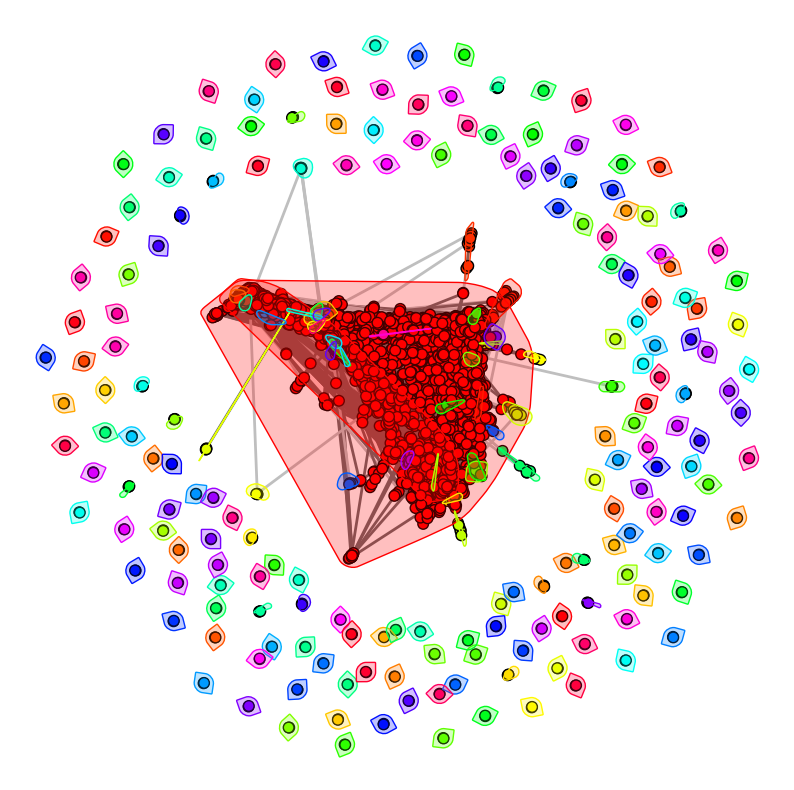

In [96]:
fig1, ax1 = plt.subplots()
ig.plot(
    communities,
    target=ax1,
    mark_groups=True,
    palette=RainbowPalette(n=len(communities)),
    vertex_size=10,
    edge_width=2,
)
fig1.set_size_inches(10, 10)

## 5.1 Creationf ot the graph, nodes and edges

In [5]:
# Create a new graph
G = ig.Graph()

# Add vertices (users) to the graph
G.add_vertices(sna_df['user_id'].unique())

# Add edges with weights calculated based on the selected combinations
for i, (user1_id, user2_id) in enumerate(user_combinations):
    weight_value = weights[i]  # Get the weight corresponding to the current combination
    G.add_edge(user1_id, user2_id, weight=weight_value)

# Visualize the graph (customize as needed)
layout = G.layout("kk")  # You can choose a different layout algorithm

# Plot the graph with smaller blue nodes
ig.plot(
    G,
    layout=layout,
    vertex_size=10,  # Adjust the size of nodes
    vertex_color='blue',  # Set the color of nodes
    edge_width=1,
    edge_color='black',
    number_of_edges=30,
)

## 5.2 Community Identification (Community Detection)
###  Community detection is an analysis that tries to identify groups of highly interconnected nodes in a network.

##### using igraph

In [19]:
# Detect communities using the Louvain algorithm
#partition = G.community_multilevel(weights='weight')


In [14]:
wtrap = G.community_walktrap(weights=G.es["weight"], steps = 4)
clust=wtrap.as_clustering()

In [19]:
visual_style = dict()
visual_style["bbox"] = (700, 600)
visual_style["vertex_size"] = 10
visual_style["vertex_label"] = None
igraph.plot(clust,mark_groups = True,**visual_style)

##### using nx

In [21]:
# Detect communities in the network using the Louvain algorithm
partition = community_louvain.best_partition(G)

'''# Display each user's community
for user_id, community_id in partition.items():
    print(f"User {user_id} belongs to the community {community_id}")'''

AttributeError: 'Graph' object has no attribute 'number_of_edges'

In [17]:
plt.figure(figsize=(10, 10))  
# draw the graph
pos = nx.spring_layout(G)
# color the nodes according to their partition
cmap = cm.get_cmap('viridis', max(partition.values()) + 1)
nx.draw_networkx_nodes(G, pos, partition.keys(), node_size=40,
                       cmap=cmap, node_color=list(partition.values()))
nx.draw_networkx_edges(G, pos, alpha=0.5)
plt.title("Visualizing the Network Graph with Node Partitioning")
plt.show()

TypeError: 'Graph' object is not iterable

<Figure size 1000x1000 with 0 Axes>

## 5.3 Node centrality
### Node centrality measures the importance of nodes in a network. There are different centrality metrics, such as degree centrality, betweenness centrality and closeness centrality.

In [9]:
# Calculate centrality measures (e.g., degree centrality, betweenness centrality and closeness centrality)
degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
closeness_centrality = nx.closeness_centrality(G)

'''# Display these centrality measures for each node
for node, degree, betweenness, closeness in zip(G.nodes(), degree_centrality.values(), betweenness_centrality.values(), closeness_centrality.values()):
    print(f"Node {node} - Degree Centrality: {degree}, Betweenness Centrality: {betweenness}, Closeness Centrality: {closeness}")'''

'# Display these centrality measures for each node\nfor node, degree, betweenness, closeness in zip(G.nodes(), degree_centrality.values(), betweenness_centrality.values(), closeness_centrality.values()):\n    print(f"Node {node} - Degree Centrality: {degree}, Betweenness Centrality: {betweenness}, Closeness Centrality: {closeness}")'

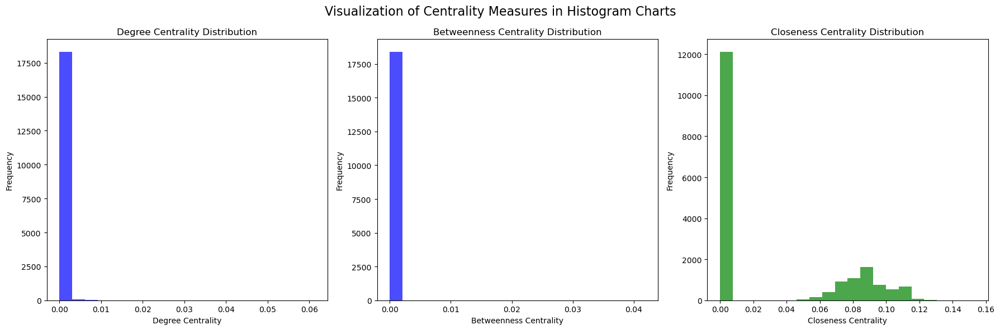

In [10]:
# Create histograms or scatter plots to visualize the centrality measures
plt.figure(figsize=(18, 6))  # Ajuste o tamanho da figura conforme necessário
plt.suptitle("Visualization of Centrality Measures in Histogram Charts", fontsize=16)

# Degree Centrality
plt.subplot(1, 3, 1)  # Uma linha, três colunas, primeiro gráfico
plt.hist(degree_centrality.values(), bins=20, alpha=0.7, color='b')
plt.xlabel('Degree Centrality')
plt.ylabel('Frequency')
plt.title('Degree Centrality Distribution')

# Betweenness Centrality
plt.subplot(1, 3, 2)  # Uma linha, três colunas, segundo gráfico
plt.hist(betweenness_centrality.values(), bins=20, alpha=0.7, color='b')
plt.xlabel('Betweenness Centrality')
plt.ylabel('Frequency')
plt.title('Betweenness Centrality Distribution')

# Closeness Centrality
plt.subplot(1, 3, 3)  # Uma linha, três colunas, terceiro gráfico
plt.hist(closeness_centrality.values(), bins=20, alpha=0.7, color='g')
plt.xlabel('Closeness Centrality')
plt.ylabel('Frequency')
plt.title('Closeness Centrality Distribution')

plt.tight_layout()
plt.show()

In [11]:
# List the 10 most central users
top_users = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:10]
print("The 10 most central users:")
for user_id in top_users:
    print(f"User {user_id}: Degree Centrality = {degree_centrality[user_id]}")

The 10 most central users:
User 6ObFF8-uKnOAlXuSH4TlyQ: Degree Centrality = 0.06132305855538069
User O6s3PIPpfMnlD362oJ7Q8Q: Degree Centrality = 0.024366418841916752
User 1ZfTuwipogg1pL4ICvHHoQ: Degree Centrality = 0.02132740001085364
User JUT0U3HTSB3kz9Wh7N0GqA: Degree Centrality = 0.020404840722852337
User zFYs8gSUYDvXkb6O7YkRkw: Degree Centrality = 0.015086557768491887
User sJprizZfXS0-g4sON33EDA: Degree Centrality = 0.01394692570684322
User juigu8XxwzLAeikeBzULbg: Degree Centrality = 0.01318717099907744
User _Ksw_vYiqToW5m6t4rAcCg: Degree Centrality = 0.012481684484723504
User 7ZQ_ttWRp-3_EfpwPAqSww: Degree Centrality = 0.011559125196722201
User dIIKEfOgo0KqUfGQvGikPg: Degree Centrality = 0.01112497964942747


In [ ]:
plt.figure(figsize=(10, 10))  
# Draw the graph
pos = nx.spring_layout(G)  # Layout for visualization
nx.draw(G, pos, with_labels=False, node_size=50)
plt.show()

## 5.4 Cluster Analysis
#### Cluster analysis groups similar nodes into clusters or groups. Let's use the K-Means cluster detection algorithm as an example

In [13]:
# Get the node positions (to use as features)
node_positions = nx.spring_layout(G)

# Convert the positions into a NumPy array
node_positions_array = np.array(list(node_positions.values()))

# Set the desired number of clusters
num_clusters = 4

# Run the K-Means algorithm
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(node_positions_array)

# Get cluster labels for each node
cluster_labels_kmeans = kmeans.labels_

'''# Display the nodes and their cluster labels
for node, label in zip(G.nodes(), cluster_labels_kmeans):
    print(f"Node {node} belongs to cluster {label}")'''

/Users/luish/anaconda3/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


'# Display the nodes and their cluster labels\nfor node, label in zip(G.nodes(), cluster_labels_kmeans):\n    print(f"Node {node} belongs to cluster {label}")'

In [ ]:
# Create a scatter plot of node positions with cluster color coding
plt.figure(figsize=(10, 10))  
for cluster_id in range(num_clusters):
    nodes_in_cluster = [node for node, label in zip(G.nodes(), cluster_labels_kmeans) if label == cluster_id]
    positions_in_cluster = {node: node_positions[node] for node in nodes_in_cluster}
    x = [pos[0] for pos in positions_in_cluster.values()]
    y = [pos[1] for pos in positions_in_cluster.values()]
    plt.scatter(x, y, label=f'Cluster {cluster_id}')

# Set labels and title
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.title('Node Clustering based on K-Means')

# Add legend
plt.legend()

# Display the plot
plt.show()

### Let's use the DBSCAN cluster detection algorithm as another approach

In [15]:
# Set the desired epsilon (maximum distance between points in the same cluster) and minimum samples
epsilon = 0.1  # Adjust this value based on your data and desired clustering density
min_samples = 50  # Adjust this value based on your data and desired minimum cluster size

# Create and fit the DBSCAN model
dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
cluster_labels_dbscan = dbscan.fit_predict(node_positions_array)

'''# Display the nodes and their cluster labels
for node, label in zip(G.nodes(), cluster_labels_dbscan):
    print(f"Node {node} belongs to cluster {label}")'''

'# Display the nodes and their cluster labels\nfor node, label in zip(G.nodes(), cluster_labels_dbscan):\n    print(f"Node {node} belongs to cluster {label}")'

In [ ]:
# Create a scatter plot of node positions with cluster color coding
plt.figure(figsize=(10, 10))  

# Extract unique cluster labels (excluding noise points labeled as -1)
unique_labels = np.unique(cluster_labels_dbscan[cluster_labels_dbscan != -1])

for label in unique_labels:
    nodes_in_cluster = [node for node, cluster_label in zip(G.nodes(), cluster_labels_dbscan) if cluster_label == label]
    positions_in_cluster = {node: node_positions[node] for node in nodes_in_cluster}
    x = [pos[0] for pos in positions_in_cluster.values()]
    y = [pos[1] for pos in positions_in_cluster.values()]
    plt.scatter(x, y, label=f'Cluster {label}')

# Mark noise points as a separate cluster (-1)
noise_points = [node for node, cluster_label in zip(G.nodes(), cluster_labels_dbscan) if cluster_label == -1]
positions_noise = {node: node_positions[node] for node in noise_points}
x_noise = [pos[0] for pos in positions_noise.values()]
y_noise = [pos[1] for pos in positions_noise.values()]
plt.scatter(x_noise, y_noise, label='Noise', c='black', marker='x')

# Set labels and title
plt.xlabel('X Position')
plt.ylabel('Y Position')
plt.title('Node Clustering based on DBSCAN')

# Add legend
plt.legend()

# Display the plot
plt.show()

In [17]:
# Create a mapping between the user ID and its position in the cluster_labels_kmeans and cluster_labels_dbscan lists
user_id_to_index = {user_id: index for index, user_id in enumerate(G.nodes())}

# Let's create empty lists to store the values of each column
user_ids = []
communities = []
degree_centrality_values = []
betweenness_centrality_values = []
closeness_centrality_values = []
cluster_kmeans_values = []
cluster_dbscan_values = []

for user_id in G.nodes():
    user_ids.append(user_id)
    communities.append(partition[user_id])  # The community to which the user belongs
    degree_centrality_values.append(degree_centrality[user_id])
    betweenness_centrality_values.append(betweenness_centrality[user_id])
    closeness_centrality_values.append(closeness_centrality[user_id])
    
    # Use the mapping to get the cluster label for K-Means
    cluster_kmeans_values.append(cluster_labels_kmeans[user_id_to_index[user_id]])
    
    # Use the mapping to get the cluster label for DBSCAN
    cluster_dbscan_values.append(cluster_labels_dbscan[user_id_to_index[user_id]])

# Create a DataFrame with the lists
data = {
    'user_id': user_ids,
    'community': communities,
    'degree_centrality': degree_centrality_values,
    'betweenness_centrality': betweenness_centrality_values,
    'closeness_centrality': closeness_centrality_values,
    'cluster_kmeans': cluster_kmeans_values,
    'cluster_dbscan': cluster_dbscan_values
}

user_df = pd.DataFrame(data)

print(tabulate(user_df.head(), headers='keys', tablefmt='pretty'))

+---+------------------------+-----------+------------------------+------------------------+----------------------+----------------+----------------+
|   |        user_id         | community |   degree_centrality    | betweenness_centrality | closeness_centrality | cluster_kmeans | cluster_dbscan |
+---+------------------------+-----------+------------------------+------------------------+----------------------+----------------+----------------+
| 0 | LpZfJekvMo5S61UBAmuyHw |     0     | 0.00037987735388288923 | 0.00013905211436468758 | 0.10912476423730783  |       0        |       0        |
| 1 | yrjT7IchufcYeN5RZJjxyw |     1     |          0.0           |          0.0           |         0.0          |       2        |       1        |
| 2 | 5aMysI3ZNdHEmRcap4LaaQ |     2     |          0.0           |          0.0           |         0.0          |       2        |       1        |
| 3 | xnNdEAZvLaKboS7YGh6Gaw |     3     |          0.0           |          0.0           |        

## 5.5 Creating the first RS with SNA-based features for users

In [5]:
city = 'Tucson'
rs_dataset, user_mapping = utils.PrepareDataFrameRS(business_df = business, 
                                                    reviews_df = reviews, 
                                                    users_df = users, 
                                                    city = city,
                                                    business_to_filter = [],
                                                    categories_to_filter = 'Sandwich')

rs_dataset

,user_id,business_id,stars
0,0,0,5
1,1,0,3
2,2,0,5
3,3,0,4
4,4,0,4
...,...,...,...
30455,18425,268,2
30456,4080,268,1
30457,18426,268,1
30458,2934,268,2


In [6]:
trainset, testset = utils.PrepareDataSurprise(df = rs_dataset, sample_size = 29158)

# Get the number of users and items in the trainset
num_users = trainset.n_users
num_items = trainset.n_items

# Get the number of ratings in the trainset
num_ratings = trainset.n_ratings

print(f"Number of users: {num_users}")
print(f"Number of items: {num_items}")
print(f"Number of ratings: {num_ratings}")

Number of users: 18282
Number of items: 269
Number of ratings: 28866


In [ ]:
train, test = utils.PrepareDataLightFM(rs_dataset, trainset, testset, user_df, user_mapping)

In [ ]:
lightfm_algo, lightfm_rmse, lightfm_predictions = utils.MatrixFactorizationLightFM(train = train, 
                                                                                   test = test, 
                                                                                   n_components = 128, 
                                                                                   learning_schedule = 'adadelta',
                                                                                   learning_rate = 0.9,
                                                                                   loss_func = 'bpr',
                                                                                   epochs = 16)

RMSE: 7.0425
